In [205]:
import numpy as np
import numpy.fft as fft
import matplotlib.pyplot as plt
import pywt
import scipy.stats

In [206]:
image = plt.imread("./img/boat.png")[:,:,0]
noisy_image = image + np.random.normal(scale=0.4,size=image.shape)

# FFT Filtering

In [207]:
def lowpass_filter_fft(X, fcx, fcy):
    
    if X.ndim == 3:
        X = X[:,:,0]
        
    l_x, l_y = np.shape(X)
    mid_x = l_x//2
    mid_y = l_y//2
    
    F = np.fft.fft2(X)
    F = np.fft.fftshift(F)
    
    F[: mid_x - fcx//2, :] = 0
    F[mid_x + fcx//2 : , : ] = 0
    F[ : ,  : mid_y - fcy//2] = 0
    F[:, mid_y + fcy//2 : ] = 0
    
    
    return np.abs(fft.ifft2(F))

Text(0.5, 1.0, 'filtered image')

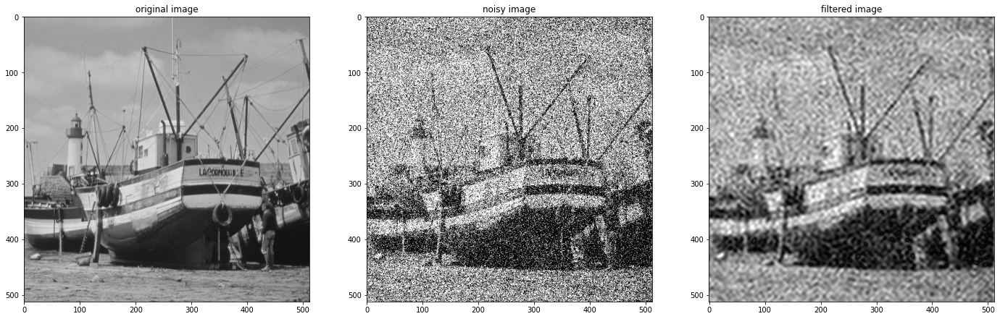

In [208]:


res = lowpass_filter_fft(noisy_image,100,100)

fig, ax = plt.subplots(1,3,figsize=(24,8))

ax[0].imshow(image, cmap='gray', vmin=0, vmax=1)
ax[0].set_title("original image")
ax[1].imshow(noisy_image, cmap='gray', vmin=0, vmax=1)
ax[1].set_title("noisy image")
ax[2].imshow(res, cmap='gray', vmin=0, vmax=1)
ax[2].set_title("filtered image")


In [209]:
def threshold_filter_fft(X, threshold):
    
    if X.ndim == 3:
        X = X[:,:,0]
    
    F = np.fft.fft2(X)
    F = np.fft.fftshift(F)

    F[np.abs(F) <= threshold] = 0
    
    return np.abs(fft.ifft2(F))

Text(0.5, 1.0, 'filtered image')

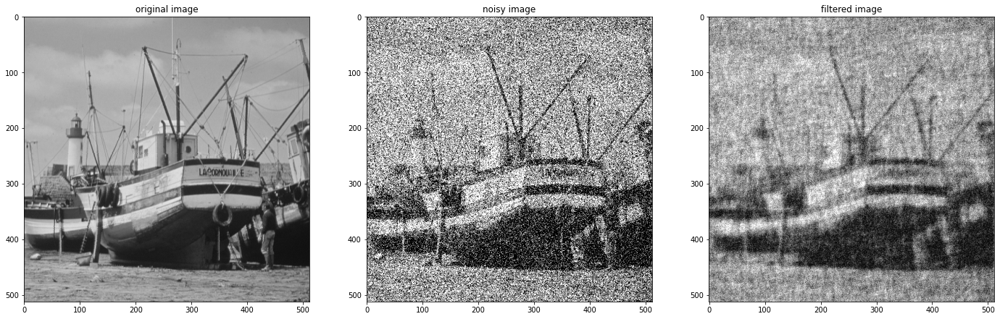

In [210]:
res = threshold_filter_fft(noisy_image,threshold=400)

fig, ax = plt.subplots(1,3,figsize=(24,8))

ax[0].imshow(image, cmap='gray', vmin=0, vmax=1)
ax[0].set_title("original image")
ax[1].imshow(noisy_image, cmap='gray', vmin=0, vmax=1)
ax[1].set_title("noisy image")
ax[2].imshow(res, cmap='gray', vmin=0, vmax=1)
ax[2].set_title("filtered image")

# Wavelet Filtering

In [211]:
def threshold_filter_wavelet(X, threshold=0.1, wavelet='db2'):
    
    if X.ndim == 3:
        X = X[:,:,0]
    wavelet = pywt.Wavelet(wavelet)
    dlen = wavelet.dec_len
    wavelet_levels = np.min([pywt.dwt_max_level(s, dlen) for s in image.shape])

    # Skip coarsest wavelet scales (see Notes in docstring).
    wavelet_levels = max(wavelet_levels - 3, 1)


    coeffs = pywt.wavedecn(X, wavelet=wavelet, level=wavelet_levels)
    dcoeffs = coeffs[1:]

    denoised_detail = [{key: pywt.threshold(level[key], value=threshold, mode="soft") for key in level} for level in dcoeffs]
    denoised_coeffs = [coeffs[0]] + denoised_detail

    return pywt.waverecn(denoised_coeffs, wavelet)


Text(0.5, 1.0, 'filtered image')

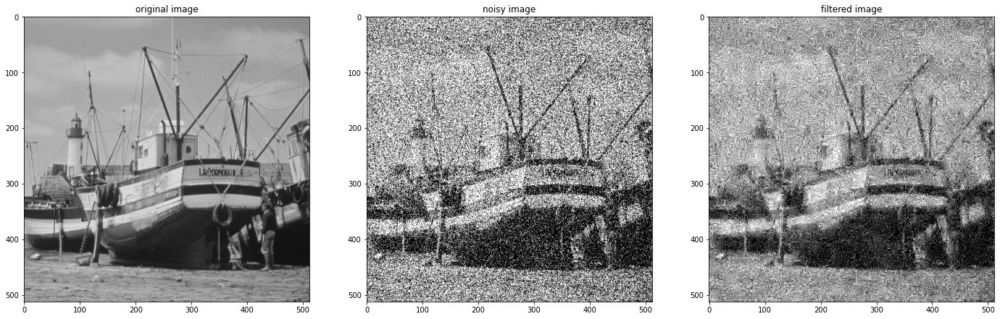

In [212]:
res = threshold_filter_wavelet(noisy_image, threshold=0.3, wavelet='db2')

fig, ax = plt.subplots(1,3,figsize=(24,8))

ax[0].imshow(image, cmap='gray', vmin=0, vmax=1)
ax[0].set_title("original image")
ax[1].imshow(noisy_image, cmap='gray', vmin=0, vmax=1)
ax[1].set_title("noisy image")
ax[2].imshow(res, cmap='gray', vmin=0, vmax=1)
ax[2].set_title("filtered image")

# Selecting best wavelets

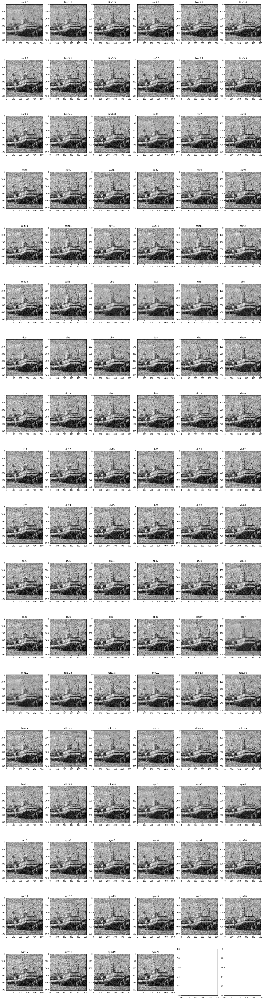

In [219]:
waves = pywt.wavelist(kind='discrete')

fig, ax = plt.subplots((len(waves)//6) + 1,6,figsize=(24,96))

for i in range(len(waves)):
    res = threshold_filter_wavelet(noisy_image, threshold=0.3, wavelet=waves[i])
    ax[i//6,i%6].imshow(res, cmap='gray', vmin=0, vmax=1)
    ax[i//6,i%6].set_title(waves[i])


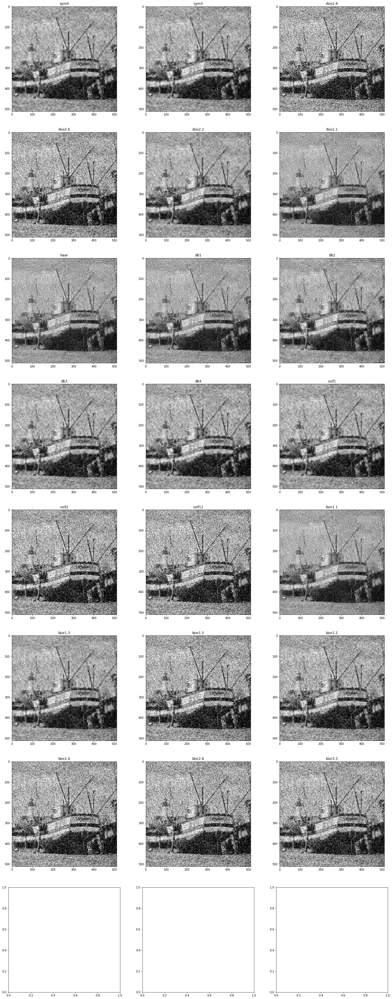

In [229]:
selected = ['sym4','sym3','rbio2.8','rbio2.6','rbio2.2','rbio1.1','haar','db1','db2','db3','db4','coif1','coif2','coif12','bior1.1','bior1.3','bior1.5','bior2.2','bior2.4','bior2.6','bior3.3']

fig, ax = plt.subplots((len(selected)//3) + 1,3,figsize=(24,64))

for i in range(len(selected)):
    res = threshold_filter_wavelet(noisy_image, threshold=0.3, wavelet=selected[i])
    ax[i//3,i%3].imshow(res, cmap='gray', vmin=0, vmax=1)
    ax[i//3,i%3].set_title(selected[i])

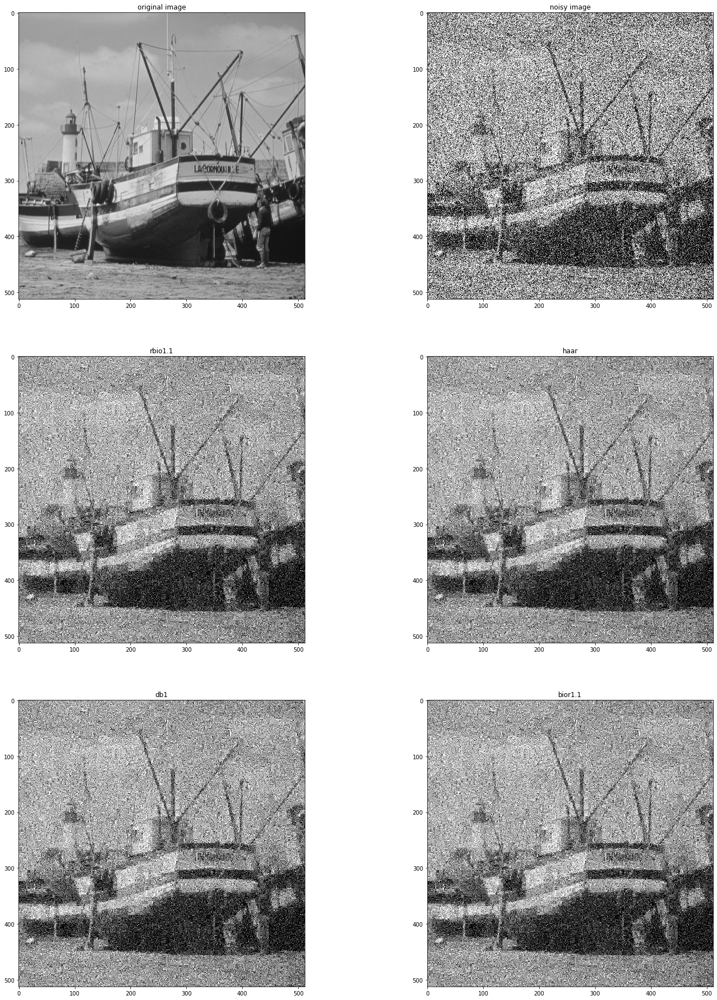

In [235]:
selected = ['rbio1.1','haar','db1','bior1.1']

fig, ax = plt.subplots((len(selected)//2) + 1,2,figsize=(24,32))

ax[0,0].imshow(image, cmap='gray', vmin=0, vmax=1)
ax[0,0].set_title("original image")
ax[0,1].imshow(noisy_image, cmap='gray', vmin=0, vmax=1)
ax[0,1].set_title("noisy image")

for i in range(len(selected)):
    res = threshold_filter_wavelet(noisy_image, threshold=0.3, wavelet=selected[i])
    ax[(i//2)+1,i%2].imshow(res, cmap='gray', vmin=0, vmax=1)
    ax[(i//2)+1,i%2].set_title(selected[i])